# 3 Outlier Removal

An outlier removal criteria will now be determined on the training set and applied to the training and test sets.

See https://journals.sagepub.com/doi/epub/10.1177/0967033519848296 for method used.

## Setup

In [23]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

from scipy.stats import f
from sklearn.cross_decomposition import PLSRegression
from sklearn.decomposition import PCA
from sklearn.covariance import MinCovDet
from scipy.signal import savgol_filter

In [24]:
# read in prepared dataset from previous step
df = pd.read_pickle("data/interim/2_partitioned.pkl")
wavelength_cols = df.filter(regex="^\d+", axis=1).columns.tolist()
descriptive_cols = [col for col in df.columns if col not in wavelength_cols]
df

,partition_1,train_partition_1,origin,population,date,season,region,cultivar,physio_stage,temp,...,1173,1176,1179,1182,1185,1188,1191,1194,1197,1200
0,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,low,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,low,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85397,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85398,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85399,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Apply basic pretreatment

Use pretreatment and wavelength range optimised for mango dmc application by Anderson 2020.

In [25]:
# apply Savitzky-Golay smoothing to the spectra
df_p = df.copy()
df_p[wavelength_cols] = df_p[wavelength_cols].apply(
    lambda row: savgol_filter(
        x=row,
        window_length=13,
        polyorder=2,
        deriv=2
    ),
    axis=1,
    result_type="expand"
)

# select wavelengths
selected_wavelengths = list(filter(lambda w: 684 <= int(w) <= 990, wavelength_cols))
df_p = df_p[
    descriptive_cols
    + selected_wavelengths
    ]

df_p

,partition_1,train_partition_1,origin,population,date,season,region,cultivar,physio_stage,temp,...,963,966,969,972,975,978,981,984,987,990
0,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,-0.002778,-0.002720,-0.002469,-0.002156,-0.001837,-0.001553,-0.001339,-0.001169,-0.001063,-0.000902
1,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,-0.002774,-0.002710,-0.002481,-0.002127,-0.001777,-0.001501,-0.001309,-0.001194,-0.001102,-0.001024
2,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,low,...,-0.003109,-0.003041,-0.002751,-0.002327,-0.001927,-0.001626,-0.001408,-0.001243,-0.001094,-0.000961
3,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,low,...,-0.003101,-0.003058,-0.002777,-0.002381,-0.001993,-0.001653,-0.001390,-0.001210,-0.001078,-0.000941
4,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,-0.002701,-0.002580,-0.002286,-0.001982,-0.001653,-0.001365,-0.001201,-0.001109,-0.001001,-0.000874
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,-0.002406,-0.002367,-0.002157,-0.001872,-0.001588,-0.001341,-0.001181,-0.001066,-0.000970,-0.000877
85397,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,-0.002354,-0.002332,-0.002155,-0.001867,-0.001554,-0.001316,-0.001163,-0.001045,-0.000957,-0.000846
85398,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,-0.002355,-0.002349,-0.002176,-0.001900,-0.001601,-0.001387,-0.001242,-0.001149,-0.001060,-0.000943
85399,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,-0.002713,-0.002724,-0.002535,-0.002211,-0.001853,-0.001588,-0.001384,-0.001240,-0.001128,-0.001019


## Split partitions

In [26]:
X_train = df_p.query("partition_1 == 'train'")[selected_wavelengths].values
Y_train = df_p.query("partition_1 == 'train'")["dry_matter"].values
X_all = df_p[selected_wavelengths].values
Y_all = df_p["dry_matter"].values

## Calculate Metrics

Refer to [Outliers detection with PLS regression for NIR spectroscopy in Python](https://nirpyresearch.com/outliers-detection-pls-regression-nir-spectroscopy-python/).

PLS model for spectra defined as:

X = T × P<sup>T</sup> + E

Where:
- X: spectra (m samples × n wavelengths matrix)
- P: loadings matrix (n × k scores matrix)
- T: scores (m × k scores matrix)
- E: error (m × n matrix)


PLS model for response variable:

Y = U × Q<sup>T</sup> + F

Where:
- Y: responses (m samples × 1 wavelengths matrix)
- Q: loadings matrix (1 × k scores matrix)
- U: scores (m × k scores matrix)
- F: error (m × 1 matrix)

In [27]:
# create and fit PLS models with 11 LVs
n_components = 11 #TODO: optimise this
pls = PLSRegression(n_components=n_components, scale=False)
pls.fit(X=X_train, Y=Y_train)

# get pls loading for fitted model
P = pls.x_loadings_

# get pls scores for training set
T_train = pls.transform(X=X_train)
T = pls.transform(X=X_all)

# calculate error matrix
E = X_all - np.dot(T, P.T)

In [28]:
df_metrics = df_p[descriptive_cols].copy()

# calculate Mahalanobis distance
mcd = MinCovDet()
robust_cov = mcd.fit(X=T_train)
df_metrics["mahalanobis_distance"] = robust_cov.mahalanobis(X=T)

# calculate Global H (GH)
df_metrics["global_h"] = df_metrics["mahalanobis_distance"]/n_components

# calculate Q-residuals (sum over the rows of the error array)
df_metrics["q_residuals"] = np.sum(E**2, axis=1)

# calculate Hotelling's T-squared (note that data is normalised by default)
df_metrics["hotellings_t_squared"] = np.sum(
    (T / np.std(T_train, axis=0))**2,
    axis=1
)

## Decide Outlier Criteria

Will examine an outlier criteria based on the training set

In [29]:
def lower_bound_1(htsq: float) -> float:
    """The lower bound for Q-residuals as a function of Hotelling's T-squared

    Args:
        htsq: Hotelling's T-squared

    Returns:
        The lower bound for the Q-residual
    """
    return 0.000000002 * htsq + 0.00081075

def lower_bound_2(htsq: float) -> float:
    """The lower bound for Q-residuals as a function of Hotelling's T-squared

    Args:
        htsq: Hotelling's T-squared

    Returns:
        The lower bound for the Q-residual
    """
    return 0.000000015 * htsq + 0.0008098

def upper_bound(htsq: float) -> float:
    """The upper bound for Q-residuals as a function of Hotelling's T-squared

    Args:
        htsq: Hotelling's T-squared

    Returns:
        The upper bound for the Q-residual
    """
    return -0.0000000085 * htsq + 0.0008125

max_hotellings_t_squared = 104

In [30]:
# plot of Hotelling's T-squared vs Q-residuals
fig = px.scatter(
    data_frame=df_metrics.query("partition_1 == 'train'"),
    x="hotellings_t_squared",
    y="q_residuals",
    color="season",
    # symbol="population",
    size_max=20,
    title="Interactive Scatter Plot",
    hover_data=["spectra_no", "season", "instrument", "population"]
)

# add boundary lines for outliers
x_values = np.linspace(
    start=df_metrics["hotellings_t_squared"].min(),
    stop=max_hotellings_t_squared,
    num=100
)
fig.add_trace(
    px.line(
        x=x_values,
        y=lower_bound_1(x_values),
    ).update_traces(line_color="red").data[0],
)
fig.add_trace(
    px.line(
        x=x_values,
        y=upper_bound(x_values),
    ).update_traces(line_color="red").data[0],
)
x_values_2 = np.linspace(
    start=70,
    stop=max_hotellings_t_squared,
    num=100
)
fig.add_trace(
    px.line(
        x=x_values_2,
        y=lower_bound_2(x_values_2),
    ).update_traces(line_color="red").data[0],
)
fig.add_trace(
    px.line(
        x=[max_hotellings_t_squared]*2,
        y=[lower_bound_1(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)]
    ).update_traces(line_color="red").data[0],
)

# show the plot
fig.update_layout(height=800)
fig.show()

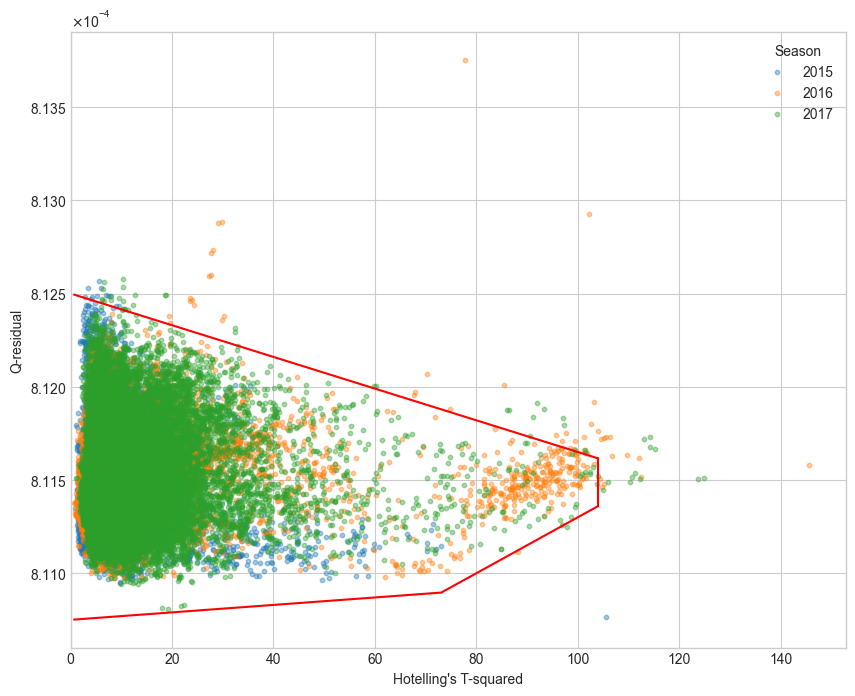

In [31]:
# PLOT for manuscript

import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter


df_train = df_metrics.query("partition_1 == 'train'")

# creating the scatter plot
plt.figure(figsize=(10, 8))
for season in df_train['season'].unique():
    season_data = df_train[df_train['season'] == season]
    plt.scatter(season_data['hotellings_t_squared'], season_data['q_residuals'], label=season, s=10, alpha=0.4)

# adding boundary lines for outliers
x_values = np.linspace(df_metrics["hotellings_t_squared"].min(), 73.2, 100)
plt.plot(x_values, lower_bound_1(x_values), color="red")
x_values = np.linspace(df_metrics["hotellings_t_squared"].min(), max_hotellings_t_squared, 100)
plt.plot(x_values, upper_bound(x_values), color="red")

x_values_2 = np.linspace(73.2, max_hotellings_t_squared, 100)
plt.plot(x_values_2, lower_bound_2(x_values_2), color="red")
plt.plot([max_hotellings_t_squared, max_hotellings_t_squared], [lower_bound_2(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)], color="red")

# setting the title and labels
plt.xlabel("Hotelling's T-squared")
plt.ylabel("Q-residual")
plt.legend(title="Season")

# Apply scientific notation to y-axis
y_formatter = ScalarFormatter(useMathText=True)
y_formatter.set_powerlimits((-3, 3))
plt.gca().yaxis.set_major_formatter(y_formatter)

# showing the plot
plt.xlim(left=0)
# plt.ylim(bottom=0)
plt.show()


## Flag Outliers and analyse

In [32]:
# remove outliers

# calculate the y-values for each sample at boundary line
lower_bound_1_values = lower_bound_1(df_metrics["hotellings_t_squared"])
lower_bound_2_values = lower_bound_2(df_metrics["hotellings_t_squared"])
upper_bound_values = upper_bound(df_metrics["hotellings_t_squared"])

# Filter the DataFrame based on the conditions defined by the lines
df_metrics["outlier_flag_1"] = 1
df_metrics.loc[
    (df_metrics["q_residuals"]  < upper_bound_values) &
    (df_metrics["q_residuals"] > lower_bound_1_values) &
    (df_metrics["q_residuals"] > lower_bound_2_values) &
    (df_metrics["hotellings_t_squared"] < max_hotellings_t_squared),
    "outlier_flag_1"
] = 0

outlier_count = df_metrics.groupby(["partition_1"])["outlier_flag_1"].agg(["count", "sum"]).reset_index()
outlier_count["pct_outliers"] = outlier_count["sum"]/outlier_count["count"]
outlier_count

,partition_1,count,sum,pct_outliers
0,anderson_external_val,1448,0,0.000000
1,holdout,5842,52,0.008901
2,train,57822,108,0.001868
3,validation,19969,471,0.023587
4,walsh_external_val,320,0,0.000000


In [33]:
# percentage flagged outliers by group
outlier_count = df_metrics.groupby(["partition_1", "instrument"])["outlier_flag_1"].agg(["count", "sum"]).reset_index()
outlier_count["pct_outliers"] = outlier_count["sum"]/outlier_count["count"]
outlier_count

,partition_1,instrument,count,sum,pct_outliers
0,anderson_external_val,15006,1448,0,0.000000
1,holdout,14002,72,0,0.000000
2,holdout,15013,240,0,0.000000
3,holdout,15014,1296,1,0.000772
4,holdout,15016,244,2,0.008197
...,...,...,...,...,...
62,validation,18029,2022,44,0.021761
63,validation,18030,626,0,0.000000
64,validation,18044,630,0,0.000000
65,validation,30004,80,1,0.012500


In [34]:
outlier_count.query("instrument == 19042")

,partition_1,instrument,count,sum,pct_outliers


In [35]:
# plot of Hotelling's T-squared vs Q-residuals
fig = px.scatter(
    data_frame=df_metrics,
    x="hotellings_t_squared",
    y="q_residuals",
    color="partition_1",
    size_max=20,
    title="Filtered Interactive Scatter Plot",
    hover_data=["spectra_no", "season", "instrument", "population", "outlier_flag_1"]
)

# add boundary lines for outliers
x_values = np.linspace(
    start=df_metrics["hotellings_t_squared"].min(),
    stop=max_hotellings_t_squared,
    num=100
)
fig.add_trace(
    px.line(
        x=x_values,
        y=lower_bound_1(x_values),
    ).update_traces(line_color="red").data[0],
)
fig.add_trace(
    px.line(
        x=x_values,
        y=upper_bound(x_values),
    ).update_traces(line_color="red").data[0],
)
x_values_2 = np.linspace(
    start=70,
    stop=max_hotellings_t_squared,
    num=100
)
fig.add_trace(
    px.line(
        x=x_values_2,
        y=lower_bound_2(x_values_2),
    ).update_traces(line_color="red").data[0],
)
fig.add_trace(
    px.line(
        x=[max_hotellings_t_squared]*2,
        y=[lower_bound_1(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)]
    ).update_traces(line_color="red").data[0],
)

# show the plot
fig.update_layout(height=800)
fig.show()

## Plot for Manuscript

Create a plot to go in the methods of upcoming manuscript.

In [36]:
df_train = df_metrics.query("partition_1 == 'train'")
df_test = df_metrics.query("partition_1 != 'train'")

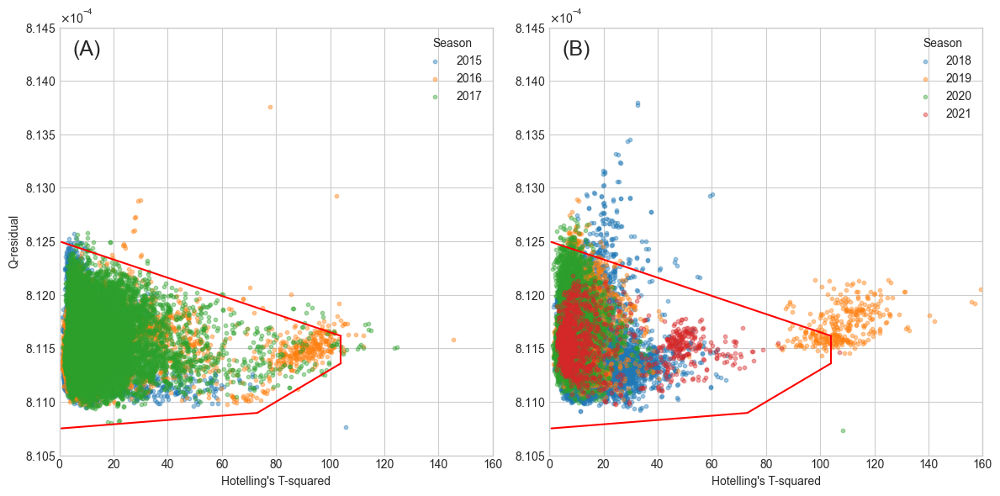

In [37]:
# PLOT for manuscript

import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter

plt.style.use('seaborn-v0_8-whitegrid')
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# creating the scatter plot for (A)
for season in df_train['season'].unique():
    season_data = df_train[df_train['season'] == season]
    axs[0].scatter(season_data['hotellings_t_squared'], season_data['q_residuals'], label=season, s=10, alpha=0.4)

# creating the scatter plot for (B)
for season in df_test['season'].unique():
    season_data = df_test[df_test['season'] == season]
    axs[1].scatter(season_data['hotellings_t_squared'], season_data['q_residuals'], label=season, s=10, alpha=0.4)

# adding boundary lines for outliers

for axis in [0, 1]:
    x_values = np.linspace(df_metrics["hotellings_t_squared"].min(), 73.2, 100)
    axs[axis].plot(x_values, lower_bound_1(x_values), color="red")
    x_values = np.linspace(df_metrics["hotellings_t_squared"].min(), max_hotellings_t_squared, 100)
    axs[axis].plot(x_values, upper_bound(x_values), color="red")
    x_values_2 = np.linspace(73.2, max_hotellings_t_squared, 100)
    axs[axis].plot(x_values_2, lower_bound_2(x_values_2), color="red")
    axs[axis].plot([max_hotellings_t_squared, max_hotellings_t_squared], [lower_bound_2(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)], color="red")

# setting the title and labels
axs[0].set_xlabel("Hotelling's T-squared")
axs[1].set_xlabel("Hotelling's T-squared")
axs[0].set_ylabel("Q-residual")
axs[0].legend(title="Season")
axs[1].legend(title="Season")

# Apply scientific notation to y-axis
y_formatter = ScalarFormatter(useMathText=True)
y_formatter.set_powerlimits((-3, 3))
for axis in [0, 1]:
    axs[axis].yaxis.set_major_formatter(y_formatter)
    # axs[axis].gca().yaxis.set_major_formatter(y_formatter)
    axs[axis].set_xlim(0, 160)
    axs[axis].set_ylim(8.105*10**(-4), 8.145*10**(-4))
    
#
axs[0].text(0.03, 0.97, '(A)', transform=axs[0].transAxes, fontsize=18, verticalalignment='top')
axs[1].text(0.03, 0.97, '(B)', transform=axs[1].transAxes, fontsize=18, verticalalignment='top')

# showing the plot
plt.tight_layout()
plt.show()

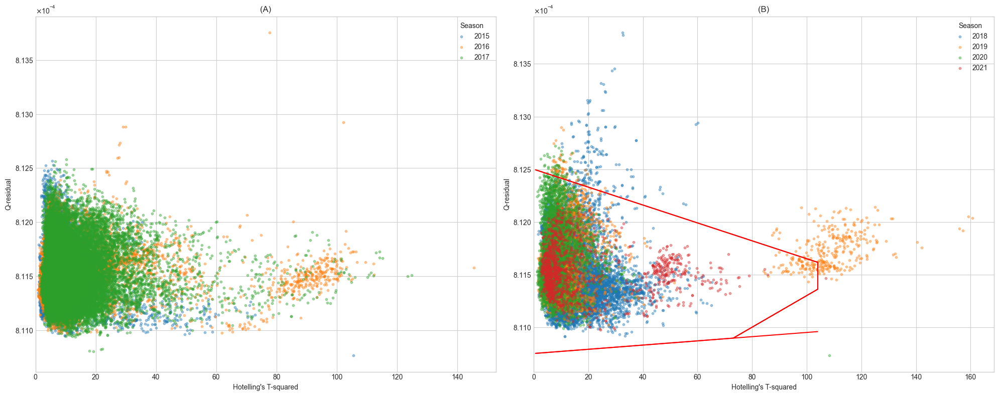

In [38]:
fig, axs = plt.subplots(1, 2, figsize=(20, 8))

# Plot (A) for 'train' partition on the first subplot
df_train = df_metrics.query("partition_1 == 'train'")
axs[0].set_title("(A)")
for season in df_train['season'].unique():
    season_data = df_train[df_train['season'] == season]
    axs[0].scatter(season_data['hotellings_t_squared'], season_data['q_residuals'], label=season, s=10, alpha=0.4)

# adding boundary lines for outliers
x_values = np.linspace(df_metrics["hotellings_t_squared"].min(), 73.2, 100)
plt.plot(x_values, lower_bound_1(x_values), color="red")
x_values = np.linspace(df_metrics["hotellings_t_squared"].min(), max_hotellings_t_squared, 100)
plt.plot(x_values, upper_bound(x_values), color="red")
x_values_2 = np.linspace(73.2, max_hotellings_t_squared, 100)
plt.plot(x_values_2, lower_bound_2(x_values_2), color="red")
plt.plot([max_hotellings_t_squared, max_hotellings_t_squared], [lower_bound_2(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)], color="red")

# Setting labels for (A)
axs[0].set_xlabel("Hotelling's T-squared")
axs[0].set_ylabel("Q-residual")
axs[0].legend(title="Season")
y_formatter = ScalarFormatter(useMathText=True)
y_formatter.set_powerlimits((-3, 3))
axs[0].yaxis.set_major_formatter(y_formatter)
axs[0].set_xlim(left=0)

# Plot (B) for 'test' partition on the second subplot
df_test = df_metrics.query("partition_1 != 'train'")
axs[1].set_title("(B)")
for season in df_test['season'].unique():
    season_data = df_test[df_test['season'] == season]
    axs[1].scatter(season_data['hotellings_t_squared'], season_data['q_residuals'], label=season, s=10, alpha=0.4)

# Adding boundary lines for outliers in (B) (same as for (A))
axs[1].plot(x_values, lower_bound_1(x_values), color="red")
axs[1].plot(x_values, upper_bound(x_values), color="red")
axs[1].plot(x_values_2, lower_bound_2(x_values_2), color="red")
axs[1].plot([max_hotellings_t_squared, max_hotellings_t_squared], [lower_bound_2(max_hotellings_t_squared), upper_bound(max_hotellings_t_squared)], color="red")

# Setting labels for (B)
axs[1].set_xlabel("Hotelling's T-squared")
axs[1].set_ylabel("Q-residual")
axs[1].legend(title="Season")
axs[1].yaxis.set_major_formatter(y_formatter)
axs[1].set_xlim(left=0)

plt.tight_layout()
plt.show()


## Perform PCA

In [39]:
# fit PCA on training data
pca = PCA(n_components=7)
# TODO: should standard scalar be applied before fitting pca
pca.fit(X=X_train)

# apply dimensionality reduction
pc_scores = pca.transform(X=X_all)

# create a DataFrame with principal component scores
pc_scores = pd.DataFrame(pc_scores)
pc_columns = [f"PC{i + 1}" for i in range(pca.n_components)]
pc_scores.columns = pc_columns

# add metta data back in
pc_scores["spectra_no"] = df_metrics["spectra_no"]
pc_scores = df_metrics.merge(pc_scores, on="spectra_no")
pc_scores

,partition_1,train_partition_1,origin,population,date,season,region,cultivar,physio_stage,temp,...,q_residuals,hotellings_t_squared,outlier_flag_1,PC1,PC2,PC3,PC4,PC5,PC6,PC7
0,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,0.000811,8.454346,0,-0.012109,0.000638,-0.000525,-0.000709,-0.001028,-0.000610,0.000321
1,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,0.000811,9.819436,0,-0.012417,0.000400,-0.000698,-0.000715,-0.000986,-0.000590,0.000432
2,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,low,...,0.000811,11.384860,0,-0.013710,0.000320,-0.001579,-0.001277,-0.001677,0.000105,0.000507
3,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,low,...,0.000811,10.740877,0,-0.013958,0.000130,-0.001697,-0.001316,-0.001634,0.000133,0.000509
4,train,calibration,published,100100,2015-09-27,2015,NT,caly,green,high,...,0.000812,11.204146,0,-0.012300,0.007329,0.000196,-0.000487,-0.001268,-0.000476,0.000186
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.000812,7.577482,0,0.007331,-0.004924,-0.001095,0.000879,0.001361,0.000353,-0.000154
85397,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.000812,6.255655,0,0.004701,-0.008305,0.000274,0.001098,0.001137,-0.000201,-0.000226
85398,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.000812,13.689503,0,-0.002394,-0.005460,-0.000945,0.000741,0.000852,-0.000225,-0.000239
85399,holdout,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,undef,...,0.000811,12.070393,0,0.008770,-0.005523,-0.000998,-0.000206,0.001667,0.000460,-0.000352


In [40]:
# interactive plot
fig = px.scatter(
    data_frame=pc_scores,
    x="PC1",
    y="PC2",
    color="outlier_flag_1",
    # symbol="partition_1",
    size_max=20,
    title="Interactive Scatter Plot",
    hover_data=["partition_1", "instrument", "population", "temp"]
)
fig.update_layout(height=800)

# Show the plot
fig.show()

## Output data

In [41]:
# create outlier flag column
outlier_flag = df_metrics.query("outlier_flag_1 == 1")[["spectra_no", "outlier_flag_1"]]
df_outliers_flagged = df.merge(
    right=outlier_flag,
    on="spectra_no",
    how="left"
)

# move the "outlier_flag_1" column to position 1
outlier_flag_1_col = df_outliers_flagged.pop("outlier_flag_1").fillna(0).astype(int)
df_outliers_flagged.insert(1, "outlier_flag_1", outlier_flag_1_col)

df_outliers_flagged

,partition_1,outlier_flag_1,train_partition_1,origin,population,date,season,region,cultivar,physio_stage,...,1173,1176,1179,1182,1185,1188,1191,1194,1197,1200
0,train,0,calibration,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,train,0,calibration,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,train,0,calibration,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,train,0,calibration,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,train,0,calibration,published,100100,2015-09-27,2015,NT,caly,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85396,holdout,0,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85397,holdout,0,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85398,holdout,0,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
85399,holdout,0,calibration,marcelo,200800,NaT,2021,QLD,keitt,green,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [42]:
# output
df_outliers_flagged.to_pickle("data/interim/3_outliers_flagged.pkl")